In [2]:
import os
import sys

import pandas as pd
import matplotlib.pyplot as plt
import matplotlib

sys.path.append(os.path.abspath(r"C:\Users\shailaja.akella\Documents\Github\dynamic_routing_analysis\src"))
sys.path.append(os.path.abspath(r"C:\Users\shailaja.akella\Documents\Github\dynamic_routing_analysis\src\dynamic_routing_analysis"))

from collections.abc import Iterable, Mapping
from typing import Any, Literal

import ccf_utils
import numpy.typing as npt
import dynamic_routing_analysis.plot_utils as pu

import numpy as np
import polars as pl



In [3]:
def get_unit_wide_table(unit_df):
    unit_metrics_cols = []

    return (
        unit_df
        .drop_nulls('dropped_variable')
        .pivot(
            on='dropped_variable',
            index=['session_id', 'unit_id', 'project', *unit_metrics_cols],
            values=['cv_test', 'cv_train', 'drop_score', 'delta_r2'],
        )
        .sort('unit_id')
        .join(
            other=(
                unit_df
                .group_by('unit_id')
                .agg(
                    pl.col('cv_test').filter(pl.col('model_label') == 'fullmodel').first().alias('cv_test_fullmodel'),
                    pl.col('cv_train').filter(pl.col('model_label') == 'fullmodel').first().alias('cv_train_fullmodel'),
                    pl.col('cv_test').filter(pl.col('model_label') == 'shift').alias('cv_test_shift'),
                    pl.col('shift_index').filter(pl.col('model_label') == 'shift'),
                    pl.col('drop_score_linear_shift', 'delta_r2_linear_shift', 'empirical_pval_linear_shift').drop_nulls().first(),
                )
            ),
            on='unit_id',
        )
    )

def add_scores_to_unit_df(unit_df):

    # --- DROPOUT METRICS ---
    fullmodel_cv_test = (
        unit_df
        .filter(pl.col("model_label") == "fullmodel")
        .select(["unit_id", "cv_test"])
        .rename({"cv_test": "fullmodel_cv_test"})
    )

    df_with_drop = (
        unit_df
        .join(fullmodel_cv_test, on="unit_id", how="left")
        .with_columns([
            pl.when(
                (pl.col("model_label") != "fullmodel") & 
                (pl.col("dropped_variable").is_not_null()) &
                (pl.col("fullmodel_cv_test") >= 0.005)
            )
            .then((1 - (pl.col("cv_test") / pl.col("fullmodel_cv_test"))).clip(0, 1))
            .otherwise(None)
            .alias("drop_score"),

            pl.when(
                (pl.col("model_label") != "fullmodel") &
                (pl.col("dropped_variable").is_not_null())
            )
            .then(pl.col("fullmodel_cv_test") - pl.col("cv_test"))
            .otherwise(None)
            .alias("delta_r2"),
        ])
        .drop("fullmodel_cv_test")
    )

    # --- LINEAR SHIFT METRICS ---
    cv_test_ref = (
        unit_df
        .filter(pl.col("shift_index") == 0)
        .select(["unit_id", "cv_test"])
        .rename({"cv_test": "cv_test_shift0"})
    )

    cv_test_median = (
        unit_df
        .filter(pl.col("shift_index") != 0)
        .group_by("unit_id")
        .agg(
            pl.median("cv_test").alias("cv_test_shift_nonzero"),
        )
    )

    null_dist = (
        unit_df
        .filter(pl.col("shift_index") != 0)
        .group_by("unit_id")
        .agg([pl.col("cv_test").alias("null_dist")])
    )


    emp_pval_df = (
        cv_test_ref
        .join(null_dist, on="unit_id", how="inner")
        .explode("null_dist")
        .group_by('unit_id')
        .agg( 
            (
                (pl.col('null_dist') >= pl.col('cv_test_shift0')).sum().add(1) / 
                (pl.col('null_dist').drop_nans().count() + 1)
            ).alias('empirical_pval_linear_shift'),
        ))


    df_with_shift = (
        unit_df
        .join(cv_test_ref, on=["unit_id"], how="left")
        .join(cv_test_median, on="unit_id", how="left")
        .join(emp_pval_df, on="unit_id", how="left")
        .with_columns([
            pl.when(
                (pl.col("model_label") != "fullmodel") & 
                (pl.col("dropped_variable").is_null()) & 
                (pl.col("shift_index") == 0) &
                (pl.col("cv_test_shift0").is_not_null()) & 
                (pl.col("cv_test_shift0") >= 0.005)
            )
            .then((1 - (pl.col("cv_test_shift_nonzero") / pl.col("cv_test_shift0"))).clip(0, 1))
            .otherwise(None)
            .alias("drop_score_linear_shift"),

            pl.when(
                (pl.col("model_label") != "fullmodel") & 
                (pl.col("dropped_variable").is_null()) &
                (pl.col("shift_index") == 0) &   
                (pl.col("cv_test_shift0").is_not_null()) & 
                (pl.col("cv_test_shift_nonzero").is_not_null())
            )
            .then(pl.col("cv_test_shift0") - pl.col("cv_test_shift_nonzero"))
            .otherwise(None)
            .alias("delta_r2_linear_shift"),

            pl.when(
                (pl.col("model_label") != "fullmodel") & 
                (pl.col("dropped_variable").is_null()) & 
                (pl.col("shift_index") == 0) &
                (pl.col("cv_test_shift0").is_not_null()) & 
                (pl.col("cv_test_shift_nonzero").is_not_null())
            )
            .then(pl.col("empirical_pval_linear_shift"))
            .otherwise(None)
            .alias("empirical_pval_linear_shift")
        ])
        .drop(["cv_test_shift0", "cv_test_shift_nonzero"])
    )

    df_shift_metrics = df_with_shift.select([
        "unit_id", "session_id", "model_label", "shift_index",
        "drop_score_linear_shift",
        "delta_r2_linear_shift",
        "empirical_pval_linear_shift"
    ])

    # Join only those into df_with_drop
    return (
        df_with_drop
        .join(df_shift_metrics, on=["unit_id", "session_id", "model_label", "shift_index"], how="left")
    )


def add_unit_metrics(unit_df):
    return (
        unit_df.lazy()
                .join(
            pl.scan_parquet('s3://aind-scratch-data/dynamic-routing/cache/nwb_components/v0.0.268/consolidated/units.parquet')
            .select('unit_id','structure','location','activity_drift','isi_violations_ratio',
                    'presence_ratio', 'amplitude_cutoff','firing_rate', 'decoder_label'),# right table
            on='unit_id',
            how = 'inner',
        ) 
    ).collect()

def get_wide_table(result_prefix, run_id): 
    return pl.scan_parquet(f"s3://aind-scratch-data/dynamic-routing/encoding/scores/{result_prefix}_{run_id}.parquet").collect()



In [4]:
wide_table = get_wide_table(result_prefix = 'v268', run_id = '1')
wide_table = add_unit_metrics(wide_table)

## All units

In [28]:
# area wise means, sorted by value of drop score, 
# 1. drop areas with all lowercase letters
# 2. drop areas whose session_id count is less than 3
# 3. drop areas if any session has less than 10 units
df_area = (
    wide_table
    .filter(pl.col("structure").cast(pl.Utf8).str.contains(r"[A-Z]"))  # Cast this too, to be safe
    .with_columns(pl.col("project").cast(pl.Utf8))  # Cast to string
    .filter(pl.col("project").str.to_lowercase() == "dynamicrouting")
    .filter(
            (pl.col("activity_drift") <= 0.2) &
            (pl.col("isi_violations_ratio") <= 0.5) &
            (pl.col("amplitude_cutoff") <= 0.1) &
            (pl.col("presence_ratio") >= 0.7)  &
            (pl.col("decoder_label") != "noise") 
    )
    .filter((pl.col('unit_id').count() >= 10).over('session_id', 'structure'))
    .group_by("location")
    .agg(
        pl.col("delta_r2_linear_shift").mean(),
        pl.col("drop_score_context").mean(),
        pl.col("delta_r2_context").mean(),
        pl.col("drop_score_linear_shift").mean(),
        pl.col("cv_test_fullmodel").mean(), 
        pl.col("session_id").n_unique().alias("session_count"),
        pl.col("unit_id").count().alias("unit_count"),
    )
    .filter(pl.col("session_count") >= 3)
)

df_area_structure = (
    wide_table
    .filter(pl.col("structure").cast(pl.Utf8).str.contains(r"[A-Z]"))  # Cast this too, to be safe
    .with_columns(pl.col("project").cast(pl.Utf8))  # Cast to string
    .filter(pl.col("project").str.to_lowercase() == "dynamicrouting")
    .filter(
            (pl.col("activity_drift") <= 0.2) &
            (pl.col("isi_violations_ratio") <= 0.5) &
            (pl.col("amplitude_cutoff") <= 0.1) &
            (pl.col("presence_ratio") >= 0.7)  &
            (pl.col("decoder_label") != "noise") 
    )
    .filter((pl.col('unit_id').count() >= 10).over('session_id', 'structure'))
    .group_by("structure")
    .agg(
        pl.col("delta_r2_linear_shift").mean(),
        pl.col("delta_r2_linear_shift").median().alias("delta_r2_linear_shift_median"),
        pl.col("drop_score_context").mean(),
        pl.col("drop_score_context").median().alias("drop_score_context_median"),
        pl.col("delta_r2_context").mean(),
        pl.col("delta_r2_context").median().alias("delta_r2_context_median"),
        pl.col("drop_score_linear_shift").mean(),
        pl.col("drop_score_linear_shift").median().alias("drop_score_linear_shift_median"),
        pl.col("cv_test_fullmodel").mean(), 
        pl.col("cv_test_fullmodel").median().alias("cv_test_fullmodel_median"),
        pl.col("session_id").n_unique().alias("session_count"),
        pl.col("unit_id").count().alias("unit_count"),

    )
    .filter(pl.col("session_count") >= 3)
)


### Fullmodel scores 

alt.HConcatChart(...)

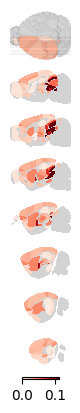

In [27]:
pu.plot_brain_heatmap(values=df_area_structure["cv_test_fullmodel_median"], 
                   regions=df_area_structure["structure"],
                   cmap = 'Reds',
                   clevels = (0, 0.11),
                   top_layer_agg_func='median',
                   sagittal_planes= [-500, -1000, -1500, -2000, -2500, -3250, -4000], 
                   interactive=True,
                   )[0]

# 3rd one! 

### Context Delta R2

alt.HConcatChart(...)

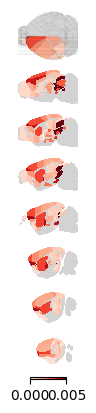

In [42]:
pu.plot_brain_heatmap(values=df_area_structure["delta_r2_context"], 
                   regions=df_area_structure["structure"],
                   cmap = 'Reds',
                   clevels = (0, 0.005),
                   top_layer_agg_func='median',
                   sagittal_planes= [-500, -1000, -1500, -2000, -2500, -3250, -4000], 
                   interactive=True,
                   )[0]

### Linear shift: Delta R2

alt.HConcatChart(...)

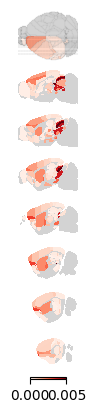

In [35]:
pu.plot_brain_heatmap(values=df_area_structure["delta_r2_linear_shift"], 
                   regions=df_area_structure["structure"],
                   cmap = 'Reds',
                   clevels = (0, 0.005),
                   top_layer_agg_func='median',
                   sagittal_planes= [-500, -1000, -1500, -2000, -2500, -3250, -4000], 
                   interactive=True,
                   )[0]

### Linear shift: Drop score

alt.HConcatChart(...)

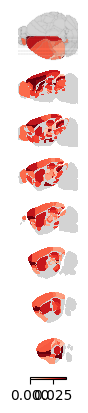

In [40]:
pu.plot_brain_heatmap(values=df_area_structure["drop_score_linear_shift"], 
                   regions=df_area_structure["structure"],
                   cmap = 'Reds',
                   clevels = (0, 0.04),
                   top_layer_agg_func='mean',
                   sagittal_planes= [-500, -1000, -1500, -2000, -2500, -3250, -4000], 
                   interactive=True,
                   )[0]


### Context drop score

alt.HConcatChart(...)

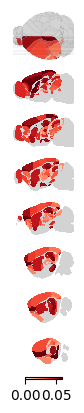

In [43]:
pu.plot_brain_heatmap(values=df_area_structure["drop_score_context"], 
                   regions=df_area_structure["structure"],
                   cmap = 'Reds',
                   clevels = (0, 0.06),
                   top_layer_agg_func='mean',
                   sagittal_planes= [-500, -1000, -1500, -2000, -2500, -3250, -4000], 
                   interactive=True,
                   )[0]

## Fraction of significant units 

In [44]:
df_area = (
    wide_table
    # Ensure 'structure' and 'project' are strings
    .filter(pl.col("structure").cast(pl.Utf8).str.contains(r"[A-Z]"))
    .with_columns(pl.col("project").cast(pl.Utf8))
    
    # Keep only DynamicRouting project
    .filter(pl.col("project").str.to_lowercase() == "dynamicrouting")
    
    # Initial unit quality filtering
    .filter(
        (pl.col("activity_drift") <= 0.2) &
        (pl.col("isi_violations_ratio") <= 0.5) &
        (pl.col("amplitude_cutoff") <= 0.1) &
        (pl.col("presence_ratio") >= 0.7) &
        (pl.col("decoder_label") != "noise")
    )
    
    # Ensure at least 10 good units per session & structure
    .filter((pl.col("unit_id").count().over(['session_id', 'structure']) >= 10))
    
    # Add session_count per structure to reuse later
    .with_columns(
        pl.col("session_id").n_unique().over("structure").alias("session_count")
    )

    # Now filter for structures with >= 3 sessions
    .filter(pl.col("session_count") >= 3)       
    
    # Calculate total units per structure
    .with_columns(
        pl.col("unit_id").count().over('structure').alias("total_units")
    )
    
    # Further filtering on firing and activity drift
    .filter(
        (pl.col("firing_rate") >= 0.5) &
        (pl.col("activity_drift") <= 0.1)
    )
    
    # Compute fraction significant
    .with_columns(
        (100 * (pl.col("empirical_pval_linear_shift") < 0.0058058058058058064).sum() / pl.col("total_units"))
        .over("structure")
        .alias("fraction_significant_units")
    )
    
    # Final aggregation
    .group_by("structure")
    .agg(
        pl.col("delta_r2_linear_shift").mean(),
        pl.col("drop_score_context").mean(),
        pl.col("delta_r2_context").mean(),
        pl.col("drop_score_linear_shift").mean(),
        pl.col("session_count").first(),
        (pl.col("empirical_pval_linear_shift") < 0.0058058058058058064).sum().alias("significant_unit_count"),
        pl.col("fraction_significant_units").first(),
        pl.col("total_units").first()
    )
    # Sort by fraction significant
    .sort("fraction_significant_units", descending=True)
)

# Set the display option to show all rows

pl.Config.set_tbl_rows(len(df_area))

print(df_area)

shape: (123, 9)
┌───────────┬───────────┬───────────┬───────────┬───┬───────────┬───────────┬───────────┬──────────┐
│ structure ┆ delta_r2_ ┆ drop_scor ┆ delta_r2_ ┆ … ┆ session_c ┆ significa ┆ fraction_ ┆ total_un │
│ ---       ┆ linear_sh ┆ e_context ┆ context   ┆   ┆ ount      ┆ nt_unit_c ┆ significa ┆ its      │
│ str       ┆ ift       ┆ ---       ┆ ---       ┆   ┆ ---       ┆ ount      ┆ nt_units  ┆ ---      │
│           ┆ ---       ┆ f64       ┆ f64       ┆   ┆ u32       ┆ ---       ┆ ---       ┆ u32      │
│           ┆ f64       ┆           ┆           ┆   ┆           ┆ u32       ┆ f64       ┆          │
╞═══════════╪═══════════╪═══════════╪═══════════╪═══╪═══════════╪═══════════╪═══════════╪══════════╡
│ SCdg      ┆ 0.005074  ┆ 0.041851  ┆ 0.006759  ┆ … ┆ 13        ┆ 18        ┆ 10.588235 ┆ 170      │
│ PP        ┆ 0.003372  ┆ 0.03704   ┆ 0.004391  ┆ … ┆ 3         ┆ 4         ┆ 7.142857  ┆ 56       │
│ GPi       ┆ 0.00233   ┆ 0.024132  ┆ 0.00333   ┆ … ┆ 4         ┆ 10       

alt.HConcatChart(...)

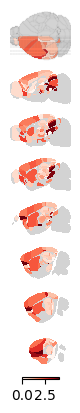

In [45]:
pu.plot_brain_heatmap(values=df_area["fraction_significant_units"], 
                   regions=df_area["structure"],
                   cmap = 'Reds',
                   clevels = (0, 4),
                   top_layer_agg_func='mean',
                   sagittal_planes= [-500, -1000, -1500, -2000, -2500, -3250, -4000], 
                   interactive=True,
                   )[0]

## Significant units only

alt.HConcatChart(...)

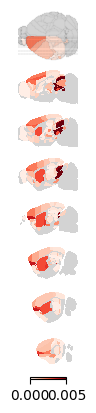

In [49]:
pu.plot_brain_heatmap(values=df_area["delta_r2_linear_shift"], 
                   regions=df_area["structure"],
                   cmap = 'Reds',
                   clevels = (0, 0.005),
                   top_layer_agg_func='mean',
                   sagittal_planes= [-500, -1000, -1500, -2000, -2500, -3250, -4000], 
                   interactive=True,
                   )[0]

In [ ]:


# plt.savefig(r"C:\Users\shailaja.akella\Dropbox (Personal)\DR\GLM_gen2\figures/sagittal_linear_shift_drop_score_all.png", dpi=300)


pu.plot_brain_heatmap(values=df_area["linear_shift_delta_r2"].to_numpy(), 
                   regions=df_area["location"].to_numpy(),
                   cmap = 'Reds',
                   clevels = (0, 0.002));
plt.title('Linear shift:$\Delta R^2$');
# plt.savefig(r"C:\Users\shailaja.akella\Dropbox (Personal)\DR\GLM_gen2\figures/sagittal_linear_shift_drop_score_all.png", dpi=300)


pu.plot_brain_heatmap(values=df_area["drop_score_context"].to_numpy(), 
                   regions=df_area["location"].to_numpy(),
                   cmap = 'Reds',
                   clevels = (0, 0.1));
plt.title('Drop score');
# plt.savefig(r"C:\Users\shailaja.akella\Dropbox (Personal)\DR\GLM_gen2\figures/sagittal_linear_shift_drop_score_all.png", dpi=300)


pu.plot_brain_heatmap(values=df_area["delta_r2_context"].to_numpy(), 
                   regions=df_area["location"].to_numpy(),
                   cmap = 'Reds',
                   clevels = (0, 0.005));
plt.title('$\Delta R^2$');
# plt.savefig(r"C:\Users\shailaja.akella\Dropbox (Personal)\DR\GLM_gen2\figures/sagittal_linear_shift_drop_score_all.png", dpi=300)

ColumnNotFoundError: "linear_shift_delta_r2" not found

shape: (87, 7)
┌───────────┬──────────────┬──────────────┬──────────────┬──────────────┬─────────────┬────────────┐
│ structure ┆ linear_shift ┆ drop_score_c ┆ delta_r2_con ┆ linear_shift ┆ session_cou ┆ unit_count │
│ ---       ┆ _delta_r2    ┆ ontext       ┆ text         ┆ _drop_score  ┆ nt          ┆ ---        │
│ str       ┆ ---          ┆ ---          ┆ ---          ┆ ---          ┆ ---         ┆ u32        │
│           ┆ f64          ┆ f64          ┆ f64          ┆ f64          ┆ u32         ┆            │
╞═══════════╪══════════════╪══════════════╪══════════════╪══════════════╪═════════════╪════════════╡
│ AUDd      ┆ 0.002363     ┆ 0.067247     ┆ 0.0035       ┆ 0.048979     ┆ 9           ┆ 58         │
│ MRN       ┆ 0.010099     ┆ 0.058263     ┆ 0.012045     ┆ 0.050918     ┆ 56          ┆ 538        │
│ AUDv      ┆ 0.002781     ┆ 0.068688     ┆ 0.003012     ┆ 0.068097     ┆ 6           ┆ 33         │
│ SSs       ┆ 0.002961     ┆ 0.059742     ┆ 0.003784     ┆ 0.049912     ┆ 26

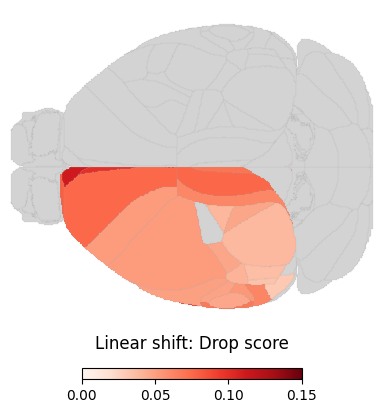

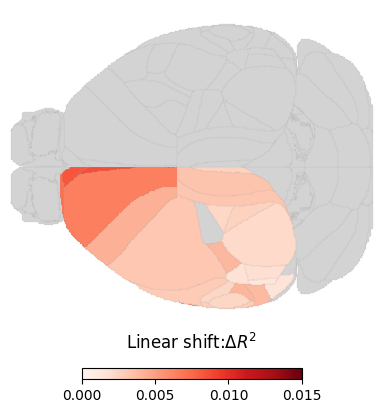

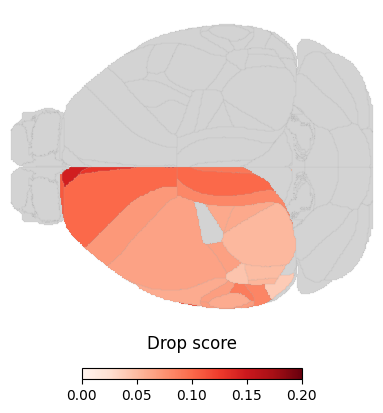

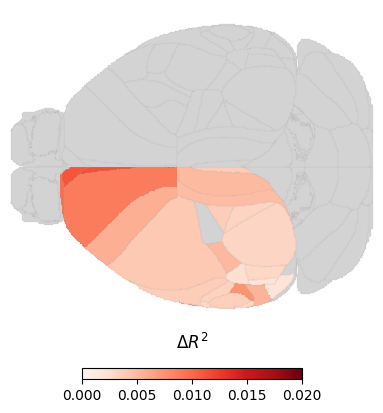

In [62]:
# area wise means, sorted by value of drop score, 
# 1. drop areas with all lowercase letters
# 2. drop areas whose session_id count is less than 3
# 3. drop areas if any session has less than 10 units

df_area_significant_only = (
    wide_table
    .with_columns(pl.col("project").cast(pl.Utf8))  # Cast to string
    .filter(pl.col("project").str.to_lowercase() == "dynamicrouting")
    .filter(pl.col("linear_shift_empirical_pval") < 0.05)
    .filter(pl.col("structure").cast(pl.Utf8).str.contains(r"^[A-Z]"))  # Cast this too, to be safe
    .group_by("structure")
    .agg(
        pl.col("linear_shift_delta_r2").mean(),
        pl.col("drop_score_context").mean(),
        pl.col("delta_r2_context").mean(),
        pl.col("linear_shift_drop_score").mean(),
        pl.col("session_id").unique().count().alias("session_count"),
        pl.col("unit_id").count().alias("unit_count")
    )
    .filter(pl.col("session_count") > 3)
    .filter(pl.col("unit_count") > 30)
)

# Set the display option to show all rows
pl.Config.set_tbl_rows(len(df_area_significant_only))

# Print the dataframe
print(df_area_significant_only)


pu.plot_brain_heatmap(values=df_area_significant_only["linear_shift_drop_score"].to_numpy(), 
                   regions=df_area_significant_only["structure"].to_numpy(),
                   cmap = 'Reds',
                   clevels = (0, 0.15));
plt.title('Linear shift: Drop score');
# plt.savefig(r"C:\Users\shailaja.akella\Dropbox (Personal)\DR\GLM_gen2\figures/sagittal_linear_shift_drop_score_all.png", dpi=300)


pu.plot_brain_heatmap(values=df_area_significant_only["linear_shift_delta_r2"].to_numpy(), 
                   regions=df_area_significant_only["structure"].to_numpy(),
                   cmap = 'Reds',
                   clevels = (0, 0.015));
plt.title('Linear shift:$\Delta R^2$');
# plt.savefig(r"C:\Users\shailaja.akella\Dropbox (Personal)\DR\GLM_gen2\figures/sagittal_linear_shift_drop_score_all.png", dpi=300)


pu.plot_brain_heatmap(values=df_area_significant_only["drop_score_context"].to_numpy(), 
                   regions=df_area_significant_only["structure"].to_numpy(),
                   cmap = 'Reds',
                   clevels = (0, 0.2));
plt.title('Drop score');
# plt.savefig(r"C:\Users\shailaja.akella\Dropbox (Personal)\DR\GLM_gen2\figures/sagittal_linear_shift_drop_score_all.png", dpi=300)


pu.plot_brain_heatmap(values=df_area_significant_only["delta_r2_context"].to_numpy(), 
                   regions=df_area_significant_only["structure"].to_numpy(),
                   cmap = 'Reds',
                   clevels = (0, 0.02));
plt.title('$\Delta R^2$');
# plt.savefig(r"C:\Users\shailaja.akella\Dropbox (Personal)\DR\GLM_gen2\figures/sagittal_linear_shift_drop_score_all.png", dpi=300)

In [53]:
from iblatlas.atlas import BrainRegions
br = BrainRegions()
br.acronym

array(['void', 'root', 'grey', ..., 'pfs', 'IPF', 'retina'], dtype=object)

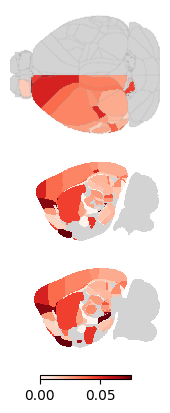

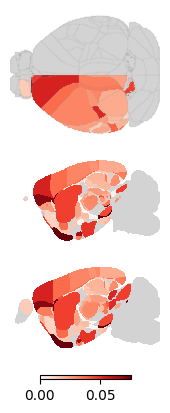

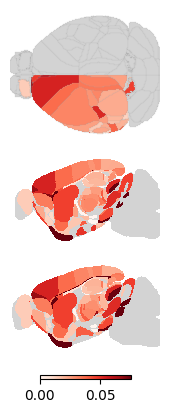

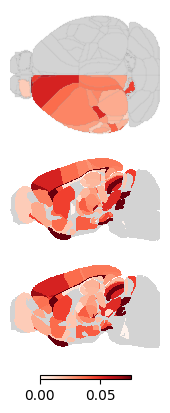

In [127]:
#barplot sorted by DR diff from median


df_area = df.groupby('areas')['drop_score_O'].mean()
unique_areas = df_area.index
excl_areas=["CTXpl","OLF","HPF","CTXsp","STR","PAL","TH","HY","MB","HB","P","MY","CB","VL","SEZ",]
unique_areas = [area for area in unique_areas if area not in excl_areas]
values = df_area[unique_areas].values

fig=pu.plot_brain_heatmap(regions=unique_areas,
                              values=values,
                              sagittal_planes= [-3200, -3400],
                              clevels=(0,0.075), cmap = 'Reds')

plt.savefig(r"C:\Users\shailaja.akella\Dropbox (Personal)\DR\GLM_gen2\figures/sagittal_ortho_3200.png", dpi=300)

fig=pu.plot_brain_heatmap(regions=unique_areas,
                              values=values,
                              sagittal_planes= [-3600, -3800],
                              clevels=(0,0.075), cmap = 'Reds')


plt.savefig(r"C:\Users\shailaja.akella\Dropbox (Personal)\DR\GLM_gen2\figures/sagittal_ortho_3600.png", dpi=300)

fig=pu.plot_brain_heatmap(regions=unique_areas,
                              values=values,
                              sagittal_planes= [-4000, -4200],
                              clevels=(0,0.075), cmap = 'Reds')


plt.savefig(r"C:\Users\shailaja.akella\Dropbox (Personal)\DR\GLM_gen2\figures/sagittal_ortho_4000.png", dpi=300)


fig=pu.plot_brain_heatmap(regions=unique_areas,
                              values=values,
                              sagittal_planes= [-4400, -4600],
                              clevels=(0,0.075), cmap = 'Reds')


plt.savefig(r"C:\Users\shailaja.akella\Dropbox (Personal)\DR\GLM_gen2\figures/sagittal_ortho_4400.png", dpi=300)



In [82]:
import altair as alt

df = (
    wide_table
    .filter(
        (pl.col("empirical_pval_linear_shift").is_not_null()) & 
        (pl.col("project").cast(pl.Utf8).str.to_lowercase() == "dynamicrouting") &
        (pl.col("activity_drift") <= 0.2) &
        (pl.col("isi_violations_ratio") <= 0.5) &
        (pl.col("amplitude_cutoff") <= 0.1) &
        (pl.col("presence_ratio") >= 0.7)  &
        (pl.col("firing_rate") >= 1) & 
        (pl.col('decoder_label') != "noise") 
    )
    .filter(pl.col("structure") == 'ORBl')
    .select(["delta_r2_sound1", "delta_r2_sound2", "delta_r2_vis1", "delta_r2_vis2"])
    # .plot.line(
    #     x=
    # )
    # .unpivot(
    #     on=['delta_r2_sound1', 'delta_r2_sound2', 'delta_r2_vis1', 'delta_r2_vis2'],
    #     index='unit_id',
    #     variable_name='delta_r2',
    # )
    # .with_columns(
    #     pl.col('delta_r2').str.split('_').list.get(-1).alias('stimulus'),
    # )
).to_numpy()

# base = (
#     alt.Chart(df)
#     .mark_point()
#     .encode(
#         x='delta_r2',
#         y='value',
#         color = 'stimulus',
#         # color_discrete_sequence=px.colors.qualitative.Plotly,
#         # title='Delta R2 values for different stimuli'
#     )
# )
# (

#     alt.Chart(df)
#     .mark_line()
#     .encode(
#         x='delta_r2',
#         y='value',
#         detail='unit_id',
#         color = 'stimulus',
#         # color_discrete_sequence=px.colors.qualitative.Plotly,
#         # title='Delta R2 values for different stimuli'
#     )
# )

 ...]

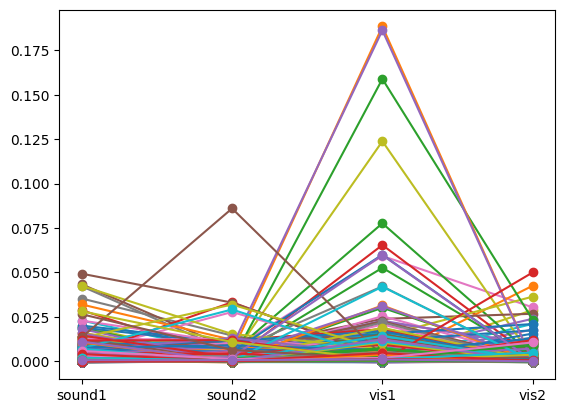

In [87]:
plt.plot(['sound1', 'sound2', 'vis1', 'vis2'], df.T, marker='o')

Schema([('session_id', String),
        ('unit_id', String),
        ('project', Enum(categories=['DynamicRouting', 'Templeton'])),
        ('cv_test_running', Float64),
        ('cv_test_miss', Float64),
        ('cv_test_sound1', Float64),
        ('cv_test_context', Float64),
        ('cv_test_vis2', Float64),
        ('cv_test_licks', Float64),
        ('cv_test_session_time', Float64),
        ('cv_test_correct_reject', Float64),
        ('cv_test_nose', Float64),
        ('cv_test_stimulus', Float64),
        ('cv_test_jaw', Float64),
        ('cv_test_false_alarm', Float64),
        ('cv_test_ears', Float64),
        ('cv_test_choice', Float64),
        ('cv_test_whisker_pad', Float64),
        ('cv_test_sound2', Float64),
        ('cv_test_facial_features', Float64),
        ('cv_test_pupil', Float64),
        ('cv_test_vis1', Float64),
        ('cv_test_hit', Float64),
        ('cv_train_running', Float64),
        ('cv_train_miss', Float64),
        ('cv_train_sound1', Float6

 ...]

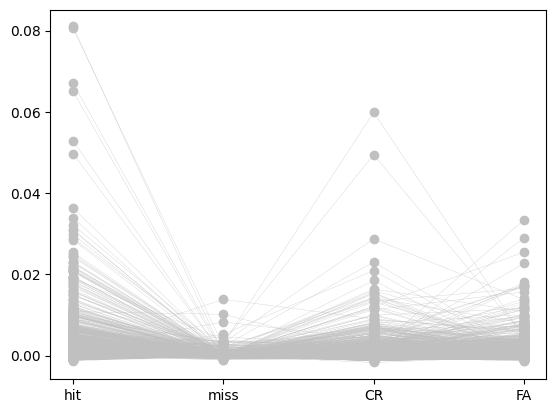

In [91]:
df = (
    wide_table
    .filter(
        (pl.col("empirical_pval_linear_shift").is_not_null()) & 
        (pl.col("project").cast(pl.Utf8).str.to_lowercase() == "dynamicrouting") &
        (pl.col("activity_drift") <= 0.2) &
        (pl.col("isi_violations_ratio") <= 0.5) &
        (pl.col("amplitude_cutoff") <= 0.1) &
        (pl.col("presence_ratio") >= 0.7)  &
        (pl.col("firing_rate") >= 1) & 
        (pl.col('decoder_label') != "noise") 
    )
    .filter(pl.col("structure") == 'ORBl')
    .select(["delta_r2_hit", "delta_r2_miss", "delta_r2_correct_reject", "delta_r2_false_alarm"])
).to_numpy()

plt.plot(['hit', 'miss', 'CR', 'FA'], df.T, marker='o', color = 'silver', lw = 0.2)

In [34]:
df_area_structure = (
    wide_table
    .filter(pl.col("structure").cast(pl.Utf8).str.contains(r"[A-Z]"))  # Cast this too, to be safe
    .with_columns(pl.col("project").cast(pl.Utf8))  # Cast to string
    .filter(pl.col("project").str.to_lowercase() == "dynamicrouting")
    .filter(
            (pl.col("activity_drift") <= 0.2) &
            (pl.col("isi_violations_ratio") <= 0.5) &
            (pl.col("amplitude_cutoff") <= 0.1) &
            (pl.col("presence_ratio") >= 0.7)  &
            (pl.col("decoder_label") != "noise") 
    )
    .filter((pl.col('unit_id').count() >= 10).over('session_id', 'structure'))
    .group_by("structure")
    .agg(
        pl.col("delta_r2_linear_shift").mean(),
        pl.col("drop_score_context").mean(),
        pl.col("delta_r2_context").mean(),
        pl.col("drop_score_linear_shift").mean(),
        pl.col("session_id").n_unique().alias("session_count"),
        pl.col("unit_id").count().alias("unit_count"),
    )
    .filter(pl.col("session_count") >= 2)
)


In [35]:
list(set(wide_table["structure"].unique())- set(df_area_structure["structure"]))

['SUM',
 'undefined',
 'RR',
 'ND',
 'PBG',
 'Pa4',
 'PRC',
 'MEA',
 'MPN',
 'root',
 'PVHd',
 'DR',
 'INC',
 'IGL',
 'PAR',
 'PeF',
 'BLAp',
 'APr',
 'IPR',
 'IMD',
 'SAG',
 'FC',
 'fi',
 'CTXsp',
 'IAD',
 'AHN',
 'III',
 'NDB',
 'Su3',
 'PPN',
 'PN',
 'CEAm',
 'lot',
 'MT',
 'NLOT2',
 'IPRL',
 'dhc',
 'CM',
 'SFO',
 'ENTm',
 'PVH',
 'int',
 'ccs',
 'AOBgl',
 'scwm',
 'cing',
 'PSTN',
 'LA',
 'PCG',
 'PR',
 'PRNc',
 'IntG',
 'ccb',
 'MPO',
 'AT',
 'P',
 'CUN',
 'fa',
 'cpd',
 'alv',
 'DT',
 'LDT',
 'SI',
 'SubG',
 'ICd',
 'ccg',
 'STN',
 'Mml',
 'out of brain',
 'ECT2/3',
 'fiber tracts',
 'DTN',
 'SCdw',
 'GRN',
 'IPC',
 'AOBmi',
 'MS',
 'or',
 'NI',
 'OT',
 'V3',
 'NLOT1',
 'fp',
 'CLI',
 'SCzo']